# Lab03-Image Processing and Analysis

In [2]:
import numpy as np 
import pandas as pd
import cv2 
from matplotlib import pyplot as plt 
from pylab import imread
from skimage.color import rgb2gray

In [ ]:
def imshows(ImageData, LabelData, rows, cols, gridType = False):
    from matplotlib import pyplot as plt
    ImageArray = list(ImageData)
    LabelArray = list(LabelData)
    if (rows == 1 & cols == 1):
        fig = plt.figure(figsize=(20,20))
    else:
        fig = plt.figure(figsize=(cols*8,rows*5))
        
    for i in range(1, cols * rows + 1):
        fig.add_subplot(rows, cols, i)
        image = ImageArray[i-1]
        if (len(image.shape) < 3):
            plt.imshow(image, plt.cm.gray)
            plt.grid(gridType)
        else:
            plt.imshow(image)
            plt.grid(gridType)
        plt.title(LabelArray[i-1])
    plt.show()

def ShowThreeImages(IM1, IM2, IM3):
    imshows([IM1, IM2, IM3], ["Image 1","Image 2", "Image 3"], 1, 3)
def ShowTwoImages(IM1, IM2):
    imshows([IM1, IM2], ["Image 1","Image 2"], 1, 2)
def ShowOneImage(IM):
    imshows([IM], ["Image"], 1, 1)
def ShowListImages(listImage, row, col):
    listCaption = []
    for i in range(len(listImage)):
        listCaption.append(str(i))
    imshows(listImage,listCaption,row,col)

### Câu 1

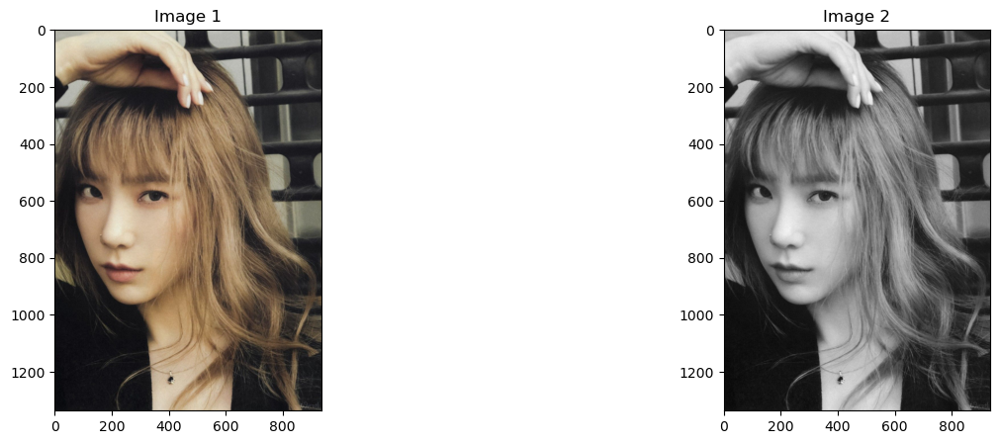

In [14]:
image_color = imread("purpose.jpg")
image_gray = cv2.cvtColor(image_color, cv2.COLOR_RGB2GRAY)

ShowTwoImages(image_color, image_gray)

#### Làm mờ ảnh với các kernel 3x3 và 5x5 

Filtering Kernel 3x3:


array([[0.11111111, 0.11111111, 0.11111111],
       [0.11111111, 0.11111111, 0.11111111],
       [0.11111111, 0.11111111, 0.11111111]], dtype=float32)

Filtering Kernel 5x5:


array([[0.04, 0.04, 0.04, 0.04, 0.04],
       [0.04, 0.04, 0.04, 0.04, 0.04],
       [0.04, 0.04, 0.04, 0.04, 0.04],
       [0.04, 0.04, 0.04, 0.04, 0.04],
       [0.04, 0.04, 0.04, 0.04, 0.04]], dtype=float32)

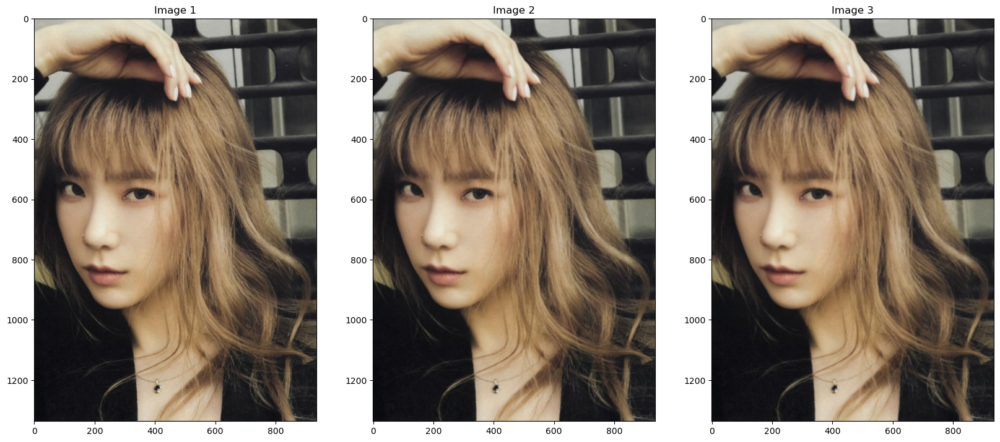

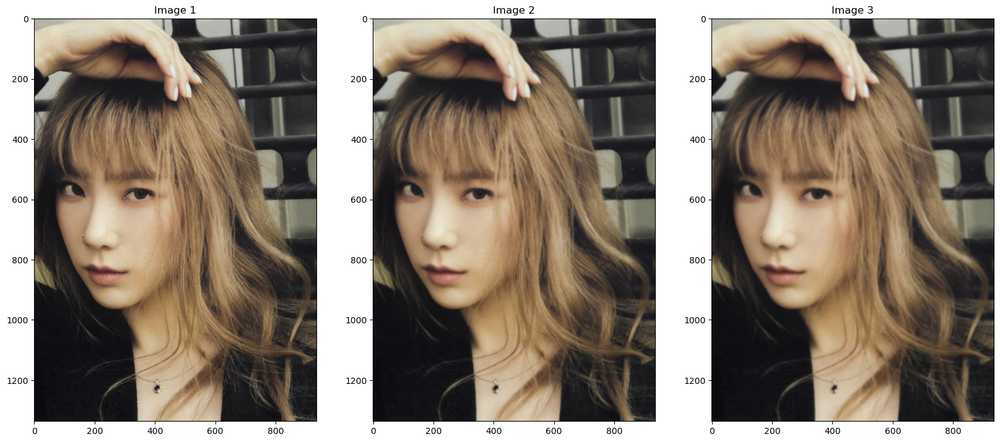

In [5]:
kernel_3x3 = np.ones((3,3),np.float32)/9
kernel_5x5 = np.ones((5,5),np.float32)/25
print("Filtering Kernel 3x3:")
display(kernel_3x3)
print("Filtering Kernel 5x5:")
display(kernel_5x5)

image_filter_3x3_1 = cv2.filter2D(image_color,-1,kernel_3x3)
image_filter_3x3_2 = cv2.filter2D(image_filter_3x3_1,-1,kernel_3x3)

image_filter_5x5_1 = cv2.filter2D(image_color,-1,kernel_5x5)
image_filter_5x5_2 = cv2.filter2D(image_filter_5x5_1,-1,kernel_5x5)

ShowThreeImages(image_color, image_filter_3x3_1, image_filter_3x3_2)
ShowThreeImages(image_color, image_filter_5x5_1, image_filter_5x5_2)

##### Nhận xét: Filter kernel 5x5 tạo ra hiệu ứng làm mờ mạnh mẽ hơn do khả năng xử lý thông tin trên vùng lớn hơn. Trong khi đó, filter kernel 3x3 thường tạo ra hiệu ứng làm mờ nhẹ hơn và ít chi tiết hơn.

#### Xuất giá trị đo mức độ mờ 

In [6]:
def variance_of_laplacian(image):
    return cv2.Laplacian(image, cv2.CV_64F).var()

#Hàm variance_of_laplacian(image) sử dụng thư viện OpenCV
#để tính độ biến thiên (phương sai) của Laplacian của một ảnh. 
#Đây là một phép đo thông tin về độ nét của ảnh dựa trên việc đánh giá
#sự biến thiên của các cường độ pixel trong ảnh.

In [9]:
# Đối với kernel 3x3
blur_mesurement = variance_of_laplacian(image_color)
blur_mesurement_3x3_1 = variance_of_laplacian(image_filter_3x3_1)
blur_mesurement_3x3_2 = variance_of_laplacian(image_filter_3x3_2)
print("Blur Measurement of image_color:", blur_mesurement)
print("Blur Measurement of image_filter_3x3_1:", blur_mesurement_3x3_1)
print("Blur Measurement of image_filter_3x3_2:", blur_mesurement_3x3_2)

Blur Measurement of image_color: 142.32373326303335
Blur Measurement of image_filter_3x3_1: 15.795307937533638
Blur Measurement of image_filter_3x3_2: 7.400229066159603


In [10]:
# Đối với kernel 5x5
blur_mesurement = variance_of_laplacian(image_color)
blur_mesurement_5x5_1 = variance_of_laplacian(image_filter_5x5_1)
blur_mesurement_5x5_2 = variance_of_laplacian(image_filter_5x5_2)
print("Blur Measurement of image_color:", blur_mesurement)
print("Blur Measurement of image_filter_5x5_1:", blur_mesurement_5x5_1)
print("Blur Measurement of image_filter_5x5_2:", blur_mesurement_5x5_2)

Blur Measurement of image_color: 142.32373326303335
Blur Measurement of image_filter_5x5_1: 5.569934693135593
Blur Measurement of image_filter_5x5_2: 2.796034435558641


##### Nhận xét: Sau khi gọi hàm variance_of_laplacian(image) để tính phương sai của Laplacian của ảnh, ta nhận thấy giá trị đo mức độ mờ của filter kernel 5x5 giảm đáng kể so với filter kernel 3x3. Điều này cho thấy filter kernel 5x5 làm mờ mạnh mẽ hơn filter kernel 3x3 

#### Viết dòng thông tin về giá trị mức độ mờ trên ảnh

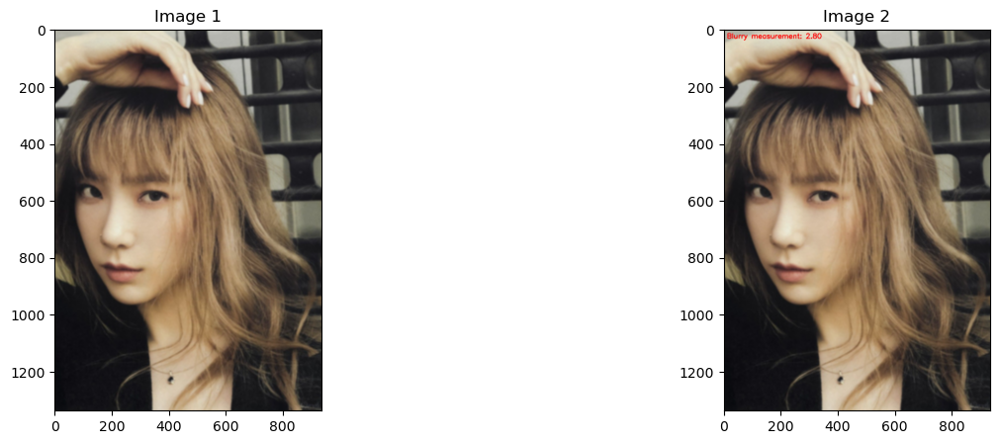

In [13]:
text = "Blurry measurement"
fm = blur_mesurement_5x5_2
image_filter_5x5_2_text = image_filter_5x5_2.copy()
cv2.putText(image_filter_5x5_2_text, "{}: {:.2f}".format(text, fm), (10, 30), cv2.FONT_HERSHEY_SIMPLEX, 0.8, (255, 0, 0), 2)
#putText() hàm thêm văn bản lên ảnh
#(10, 30): tọa độ (x, y) của text lên ảnh
#0.8 kích cỡ chữ, (255, 0, 0): màu đỏ, 2: width of text
ShowTwoImages(image_filter_5x5_2, image_filter_5x5_2_text)

### Câu 2

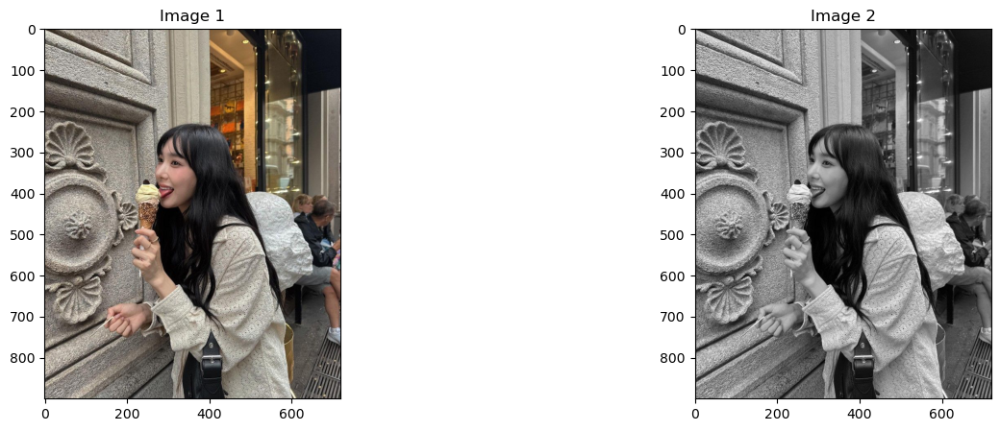

In [16]:
image_color = imread("tiffanycute.jpg")
image_gray = cv2.cvtColor(image_color, cv2.COLOR_RGB2GRAY)

ShowTwoImages(image_color, image_gray)

#### Làm rõ ảnh với các kernel 3x3 và 5x5 

Filtering kernel sharpen 3x3:


array([[-1, -1, -1],
       [-1,  9, -1],
       [-1, -1, -1]])

Filtering kernel sharpen 5x5:


array([[-1, -1, -1, -1, -1],
       [-1, -1, -1, -1, -1],
       [-1, -1, 25, -1, -1],
       [-1, -1, -1, -1, -1],
       [-1, -1, -1, -1, -1]])

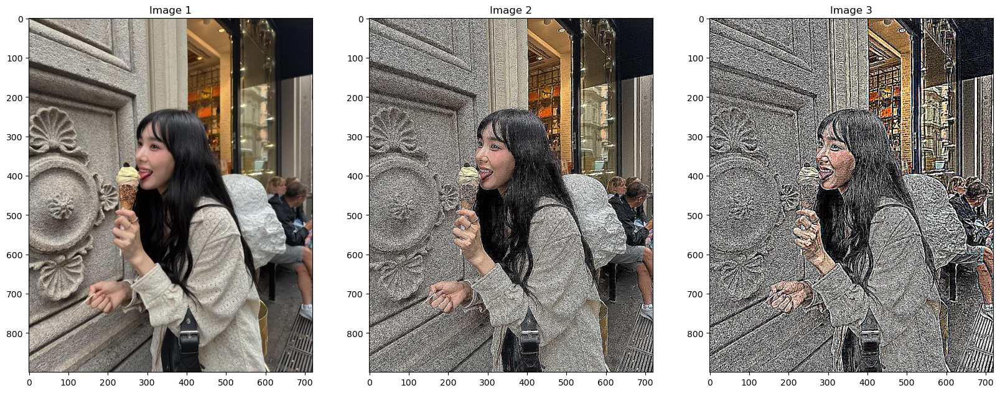

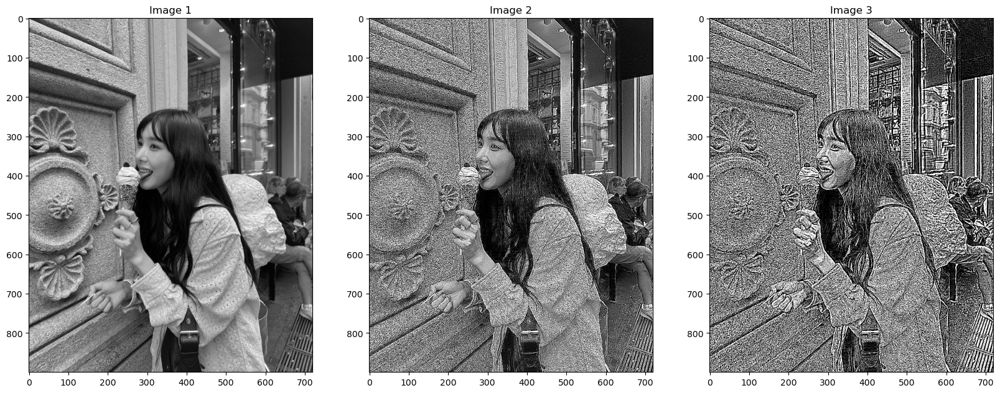

In [28]:
kernel_sharpen_3x3 = np.array([[-1, -1, -1],
                               [-1, 9, -1],
                               [-1, -1, -1]])
kernel_sharpen_5x5 = np.array([[-1, -1, -1,-1,-1],
                               [-1, -1, -1,-1,-1],
                               [-1, -1, 25,-1,-1],
                               [-1, -1, -1,-1,-1],
                               [-1, -1, -1,-1,-1]],dtype = int)
print("Filtering kernel sharpen 3x3:")
display(kernel_sharpen_3x3)
print("Filtering kernel sharpen 5x5:")
display(kernel_sharpen_5x5)

image_sharpen_1 = cv2.filter2D(image_color,-1,kernel_sharpen_3x3)
image_gray_sharpen_1 = cv2.filter2D(image_gray, -1, kernel_sharpen_3x3)

image_sharpen_2 = cv2.filter2D(image_color,-1,kernel_sharpen_5x5)
image_gray_sharpen_2 = cv2.filter2D(image_gray, -1, kernel_sharpen_5x5)

ShowThreeImages(image_color, image_sharpen_1, image_sharpen_2)
ShowThreeImages(image_gray, image_gray_sharpen_1, image_gray_sharpen_2)

##### Nhận xét: kernel_sharpen_3x3 và kernel_sharpen_5x5 có trọng số khác nhau do đó tạo ra hiệu ứng làm rõ khác nhau trên ảnh. Tương tự như làm mờ, filter kernel 5x5 làm rõ mạnh mẽ hơn filter kernel 3x3

#### Xuất giá trị đo mức độ rõ 


In [30]:
print("Sharpen Measurement of image_color:", variance_of_laplacian(image_color))
print("Sharpen Measurement of image_sharpen_1:", variance_of_laplacian(image_sharpen_1))
print("Sharpen Measurement of image_sharpen_2:", variance_of_laplacian(image_sharpen_2))
print("------------------------------------------------------------------------------")
print("Sharpen Measurement of image_gray:", variance_of_laplacian(image_gray))
print("Sharpen Measurement of image_gray_sharpen_1:", variance_of_laplacian(image_gray_sharpen_1))
print("Sharpen Measurement of image_gray_sharpen_2:", variance_of_laplacian(image_gray_sharpen_2))

Sharpen Measurement of image_color: 7228.576572314945
Sharpen Measurement of image_sharpen_1: 140600.09507173585
Sharpen Measurement of image_sharpen_2: 171769.55892636027
------------------------------------------------------------------------------
Sharpen Measurement of image_gray: 7226.294971362192
Sharpen Measurement of image_gray_sharpen_1: 140585.58668672698
Sharpen Measurement of image_gray_sharpen_2: 171567.04520836


##### Nhận xét: Ta thấy giá trị đo mức độ rõ của filter kernel 5x5 (image_sharpen_2) lớn hơn so với filter kernel 3x3 (image_sharpen_1), do đó sử dụng filter kernel 5x5 làm rõ mạnh hơn filter kernel 3x3

#### Viết dòng thông tin về giá trị mức độ rõ trên ảnh

In [31]:
def text_Sharpen(image):
  text = "Sharpen measurement"
  fm = variance_of_laplacian(image)
  cv2.putText(image,"{}: {:.2f}".format(text,fm),(10,30),cv2.FONT_HERSHEY_SIMPLEX, 0.8, (255, 0, 0), 2)
  ShowOneImage(image)

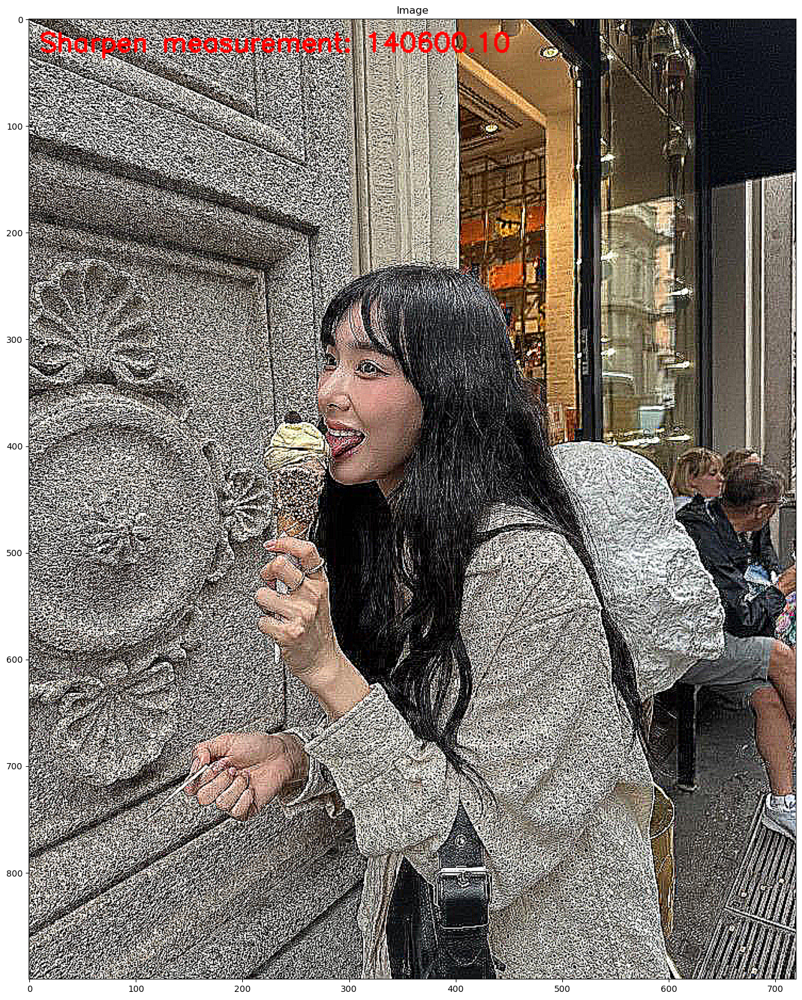

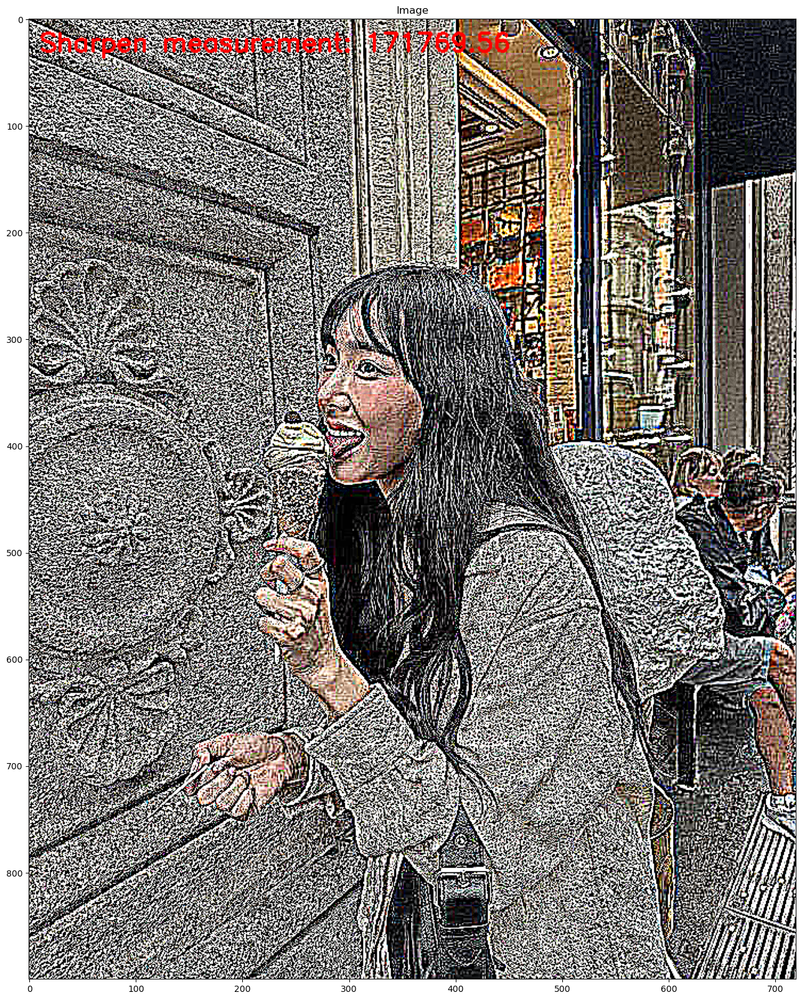

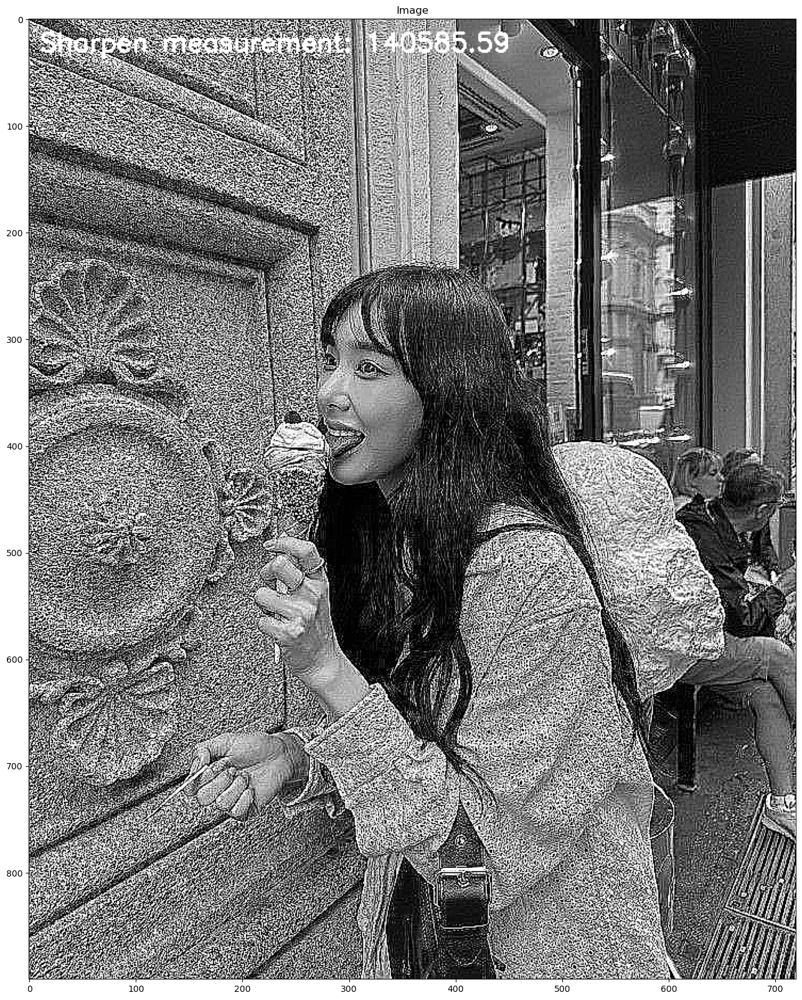

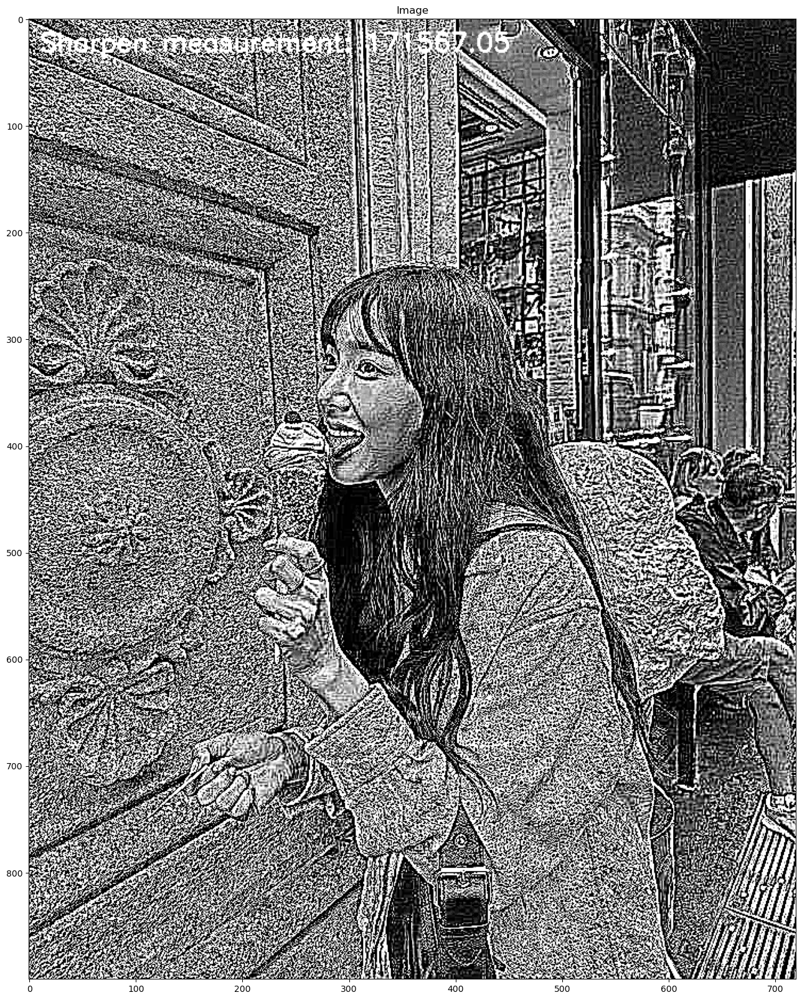

In [32]:
text_Sharpen(image_sharpen_1)
text_Sharpen(image_sharpen_2)
text_Sharpen(image_gray_sharpen_1)
text_Sharpen(image_gray_sharpen_2)

### Câu 3

#### Viết hàm đọc toàn bộ ảnh trong thư mục “Image_Input” đó vào một List ảnh

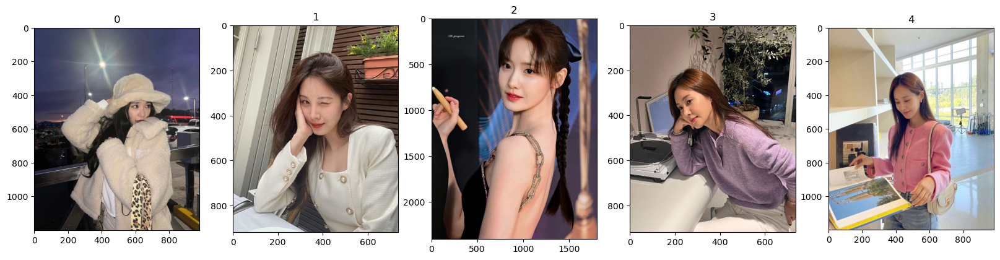

In [58]:
import os
from os.path import join
data = r'C:\Users\Admin\Downloads\HCMUS\HK1 (23-24)\Phân tích và xử lý ảnh\Lab03\image'

def read_img(folder):
  imgs = os.listdir(folder)
  image = list()
  for img in imgs:
    image.append(imread(os.path.join(folder,img)))
  ShowListImages(image,1,5)

read_img(data)

#### Định nghĩa ngưỡng mờ dựa trên giá độ đo mờ


In [57]:
blur_threshold = 150

#### Đọc lần lượt các ảnh : nếu ảnh nào ngoài ngưỡng mờ ta ghi một dòng thông tin trên ảnh là “Blur Image :” kèm giá trị mờ. Nếu ảnh nào tốt thì ta ghi “Good Image” trên ảnh. 


In [61]:
output_image =  r'C:\Users\Admin\Downloads\HCMUS\HK1 (23-24)\Phân tích và xử lý ảnh\Lab03\image_output'
imgs = os.listdir(data)
for img in imgs:
    image_path = os.path.join(data, img)
    image = cv2.imread(image_path)

    if image is not None:
        blur_score = cv2.Laplacian(image, cv2.CV_64F).var()

        if blur_score < blur_threshold:
            # Blur image
            cv2.putText(image, "{}: {:.2f}".format("Blur Image", blur_score), (10, 30), cv2.FONT_HERSHEY_SIMPLEX, 0.8, (0, 0, 255), 2)

        else:
            # Good image
            cv2.putText(image, 'Good Image', (10, 30), cv2.FONT_HERSHEY_SIMPLEX, 0.8, (0, 0, 255), 2)

        # Save image
        output_path = os.path.join(output_image, img)
        cv2.imwrite(output_path, image)

#### Tất cả các ảnh sau khi đánh giá được lưu vào một thư mục “Image_BlurDetection_Output”


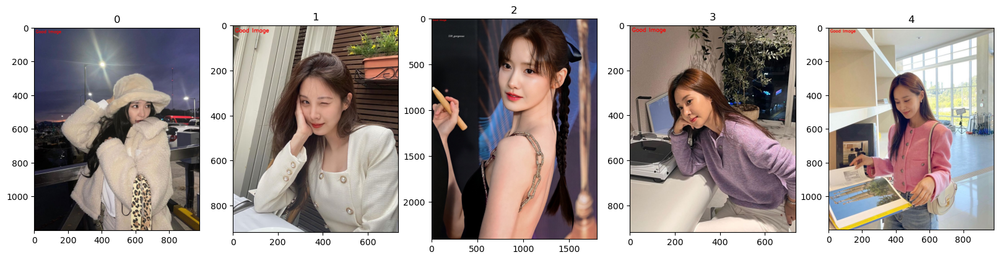

In [62]:
os.chdir(output_image)
read_img(output_image)

### Câu 4

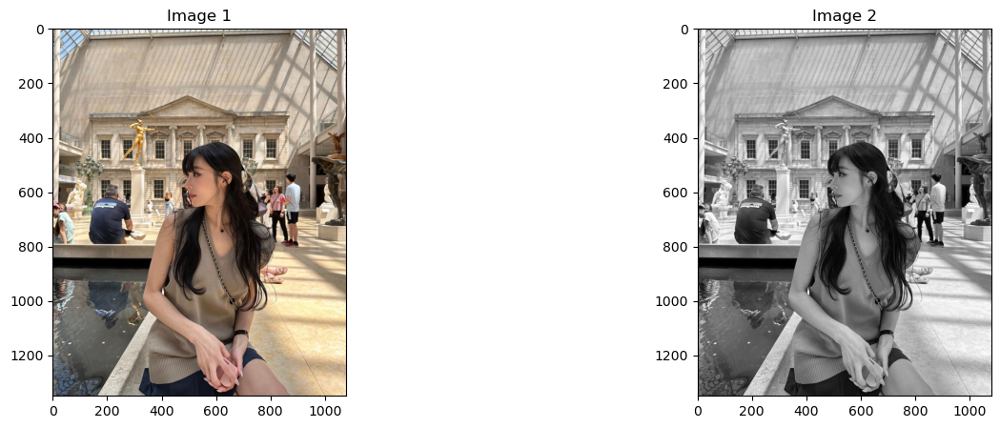

In [69]:
dir = r'C:\Users\Admin\Downloads\HCMUS\HK1 (23-24)\Phân tích và xử lý ảnh\Lab03'

image_color = imread(os.path.join(dir, "ppany.jpg"))
image_gray = cv2.cvtColor(image_color, cv2.COLOR_RGB2GRAY)

ShowTwoImages(image_color, image_gray)

#### Xuất ảnh từng điểm ảnh hiển thị giá trị RGBMax 


In [70]:
def max_rbg_filter(image):
  (B,G,R) = cv2.split(image) # chia ảnh ra 3 kênh màu riêng biệt
  # tìm giá trị cường độ pixel tối đa cho mỗi
  # tọa độ (x,y), sau đó đặt tất cả giá trị nhỏ hơn M = 0
  M = np.maximum(np.maximum(R,G),B)
  R[R < M] = 0
  G[G < M] = 0
  B[B < M] = 0
  # hợp nhất các kênh màu lại với nhau
  return cv2.merge([B,G,R])

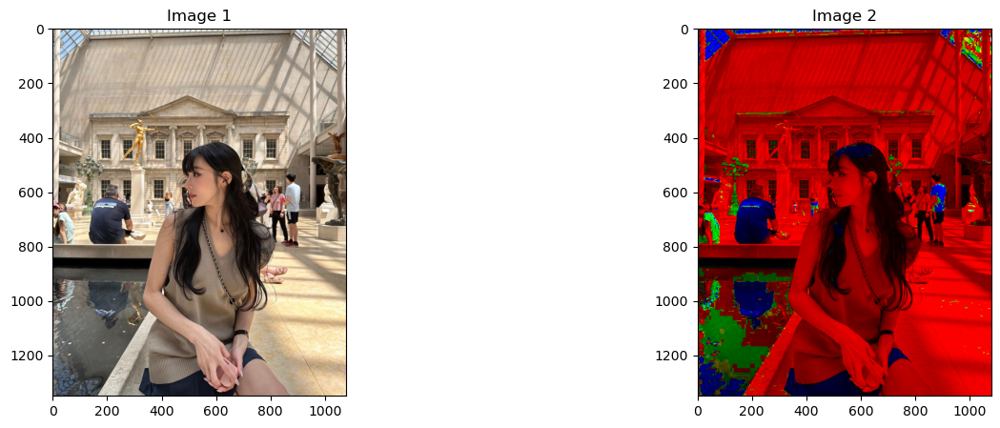

In [71]:
img_rbgmax = max_rbg_filter(image_color)
ShowTwoImages(image_color,img_rbgmax)

#### Xuất các vị trí có giá trị R đạt max, G đạt max và B đạt max


In [73]:
def max_rgb_finder(image):
    # Chia từng kênh B, G, R
    (B, G, R) = cv2.split(image)

    # Tìm giá trị cường độ pixel tối đa cho mỗi kênh
    max_R = np.max(R)
    max_G = np.max(G)
    max_B = np.max(B)

    # Tìm vị trí mà R, G và B đạt giá trị cực đại
    max_R_indices = np.argwhere(R == max_R)
    max_G_indices = np.argwhere(G == max_G)
    max_B_indices = np.argwhere(B == max_B)

    # Đặt tất cả các giá trị pixel nhỏ hơn giá trị tối đa thành 0
    R[R < max_R] = 0
    G[G < max_G] = 0
    B[B < max_B] = 0

    # Hợp nhất các kênh màu
    result_image = cv2.merge([B, G, R])

    return result_image, max_R_indices, max_G_indices, max_B_indices
image_color_rgbmax, max_R_indices, max_G_indices, max_B_indices = max_rgb_finder(image_color)

# Hiển thị vị trí có giá trị R, G, B đạt max
print("Vị trí có giá trị R đạt max: \n", max_R_indices)
print("---------------------------------")
print("Vị trí có giá trị G đạt max: \n", max_G_indices)
print("---------------------------------")
print("Vị trí có giá trị B đạt max: \n", max_B_indices)

Vị trí có giá trị R đạt max: 
 [[   0    3]
 [   0   33]
 [   0   48]
 ...
 [1155   68]
 [1156   60]
 [1156   67]]
---------------------------------
Vị trí có giá trị G đạt max: 
 [[   0  122]
 [   0  123]
 [   0  589]
 ...
 [1345  189]
 [1346  176]
 [1348  178]]
---------------------------------
Vị trí có giá trị B đạt max: 
 [[   0   23]
 [   0   24]
 [   0  111]
 ...
 [1348 1046]
 [1348 1047]
 [1348 1072]]


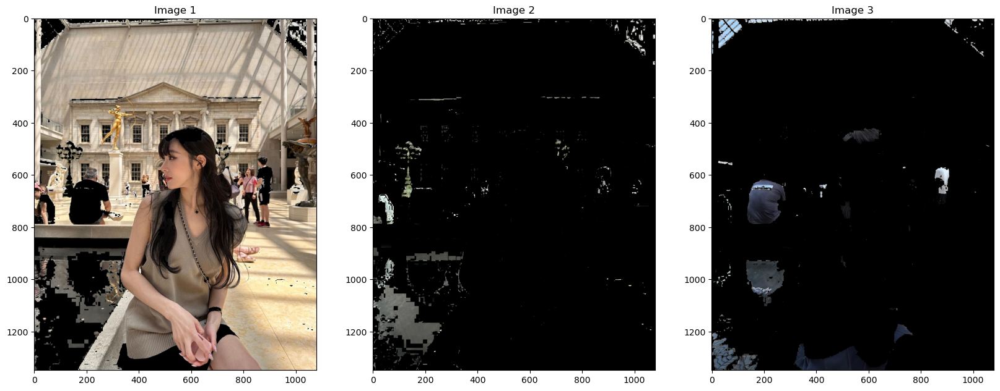

In [75]:
def segmentcolorByMask(image,mask):
  mask = mask.astype(np.uint8)
  result = cv2.bitwise_and(image, image, mask = mask)
  return result

img_gray = cv2.cvtColor(image_color, cv2.COLOR_RGB2GRAY)
img_maxR_mask = img_gray < 0
img_maxB_mask = img_gray < 0
img_maxG_mask = img_gray < 0
R = img_rbgmax[:,:,0]
B = img_rbgmax[:,:,1]
G = img_rbgmax[:,:,2]

img_maxR_mask[(B == 0) & (G == 0)] = 1
img_maxB_mask[(R == 0) & (G == 0)] = 1
img_maxG_mask[(R == 0) & (B == 0)] = 1

img_maxR = segmentcolorByMask(image_color, img_maxR_mask)
img_maxB = segmentcolorByMask(image_color, img_maxB_mask)
img_maxG = segmentcolorByMask(image_color, img_maxG_mask)

ShowThreeImages(img_maxR, img_maxB, img_maxG)

#### Thưc hiện làm mờ ảnh rồi sau đó làm rõ ảnh và so sánh giá trị độ đo mờ có giống ảnh gốc không 


Đo độ mờ của ảnh gốc:  25742.954050736924
Đo độ mờ của ảnh đã làm mờ thành làm rõ: 2446.3442961503843
Giá trị độ đo mờ không giống ảnh gốc


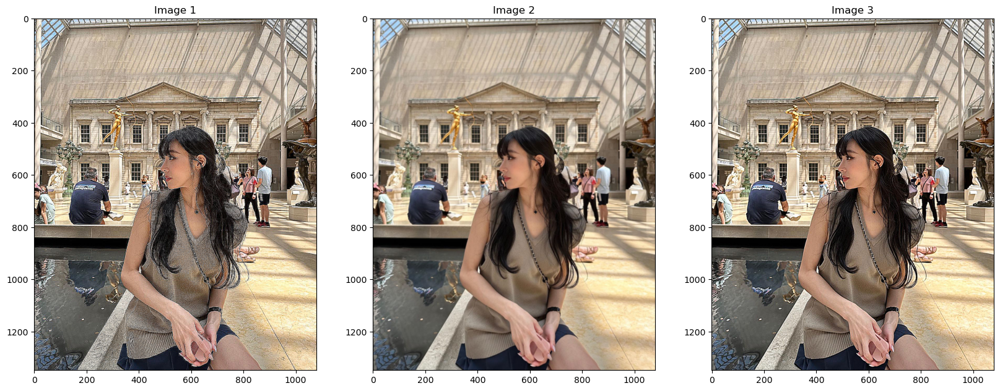

In [77]:
#Làm mờ ảnh:
img_color_blur = cv2.filter2D(image_color,-1, kernel_3x3)
#Làm rõ ảnh lại:
img_color_sharpen = cv2.filter2D(img_color_blur, -1, kernel_sharpen_3x3)
#Làm rõ ảnh gốc:
img = cv2.filter2D(image_color,-1,kernel_sharpen_3x3)

blur_measurement = variance_of_laplacian(img)
print('Đo độ mờ của ảnh gốc: ', blur_measurement)
bm_blur_sha = variance_of_laplacian(img_color_sharpen)
print('Đo độ mờ của ảnh đã làm mờ thành làm rõ:', bm_blur_sha)
if (bm_blur_sha!=blur_measurement):
    print("Giá trị độ đo mờ không giống ảnh gốc")
else:
    print("Giá trị độ đo mờ giống ảnh gốc")

ShowThreeImages(img,img_color_blur,img_color_sharpen)

#### Thưc hiện làm rõ ảnh rồi sau đó làm mờ ảnh và so sánh giá trị độ đo mờ có giống ảnh gốc không


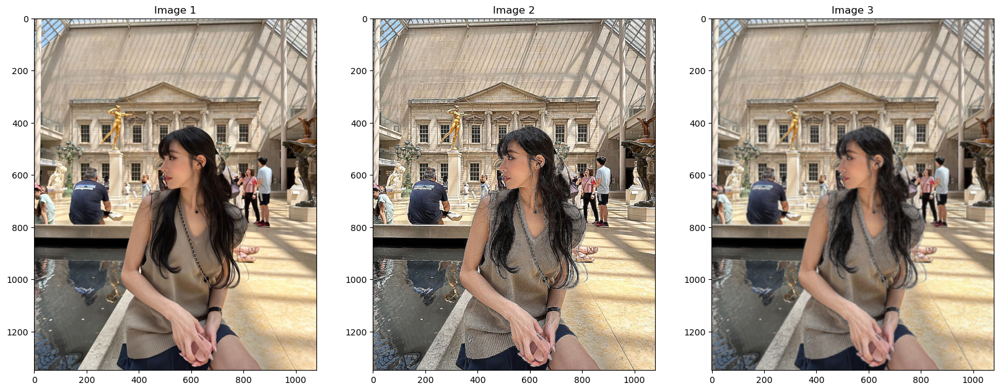

Độ đo mờ của ảnh gốc: 229.95161440296053
Độ đo mờ của ảnh sau khi làm rõ: 25742.954050736924
Độ đo mờ của ảnh sau khi tiếp tục làm mờ: 19.660355380085825


In [78]:
# Làm rõ ảnh
sharp_kernel = np.array([[-1, -1, -1],
                        [-1, 9, -1],
                        [-1, -1, -1]])
sharpened_image = cv2.filter2D(image_color, -1, sharp_kernel)

# Làm mờ ảnh
blurred_image = cv2.GaussianBlur(sharpened_image, (11, 11), 0)

ShowThreeImages(image_color, sharpened_image, blurred_image)

# So sánh giá trị độ đo mờ
original_score = cv2.Laplacian(image, cv2.CV_64F).var()
sharpened_image_score = cv2.Laplacian(sharpened_image, cv2.CV_64F).var()
blurred_image_score = cv2.Laplacian(blurred_image, cv2.CV_64F).var()

print(f"Độ đo mờ của ảnh gốc: {original_score}")
print(f"Độ đo mờ của ảnh sau khi làm rõ: {sharpened_image_score}")
print(f"Độ đo mờ của ảnh sau khi tiếp tục làm mờ: {blurred_image_score}")

#### Tìm cạnh và tạo ra các ảnh về cạnh sau : ảnh cạnh ngang, cạnh dọc và ảnh cạnh tổng 

In [79]:
#Xây dựng ma trận để xuất ảnh các cạnh của từng vùng của hình ảnh
kernel_sobel_X = np.array(([-1, 0, 1],
                           [-2, 0, 2],
                           [-1, 0, 1]), dtype = "int")

kernel_sobel_Y = np.array(([-1, -2, -1],
                           [0, 0, 0],
                           [1, 2, 1]), dtype = "int")

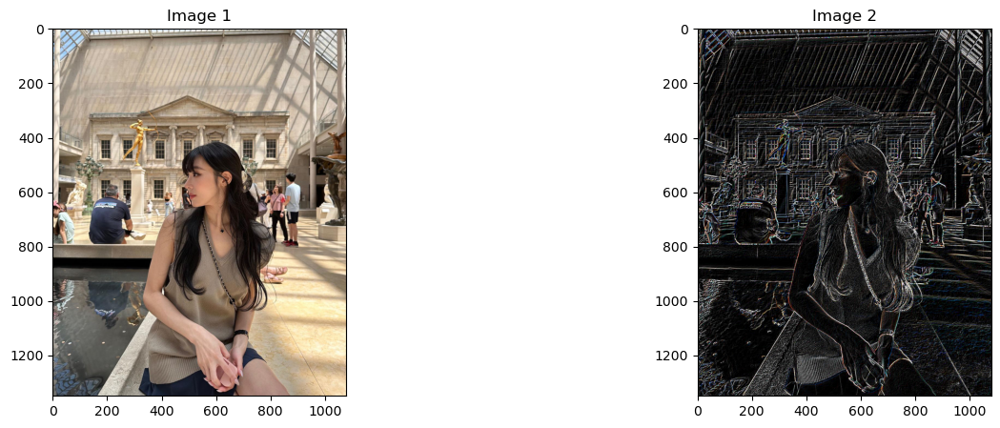

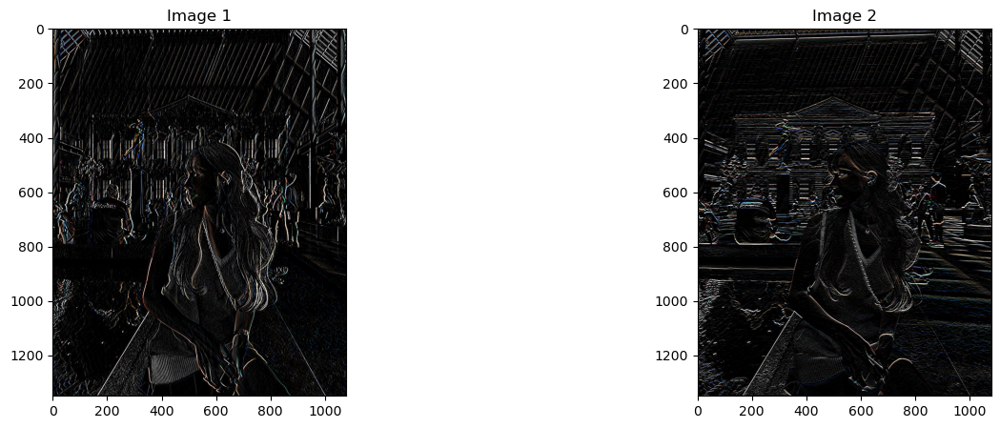

In [80]:
# Xuất ảnh màu
image_color_edge_sobelX = cv2.filter2D(image_color, -1, kernel_sobel_X)
image_color_edge_sobelY = cv2.filter2D(image_color, -1, kernel_sobel_Y)
image_color_edge = image_color_edge_sobelX + image_color_edge_sobelY

ShowTwoImages(image_color, image_color_edge)
ShowTwoImages(image_color_edge_sobelX, image_color_edge_sobelY)

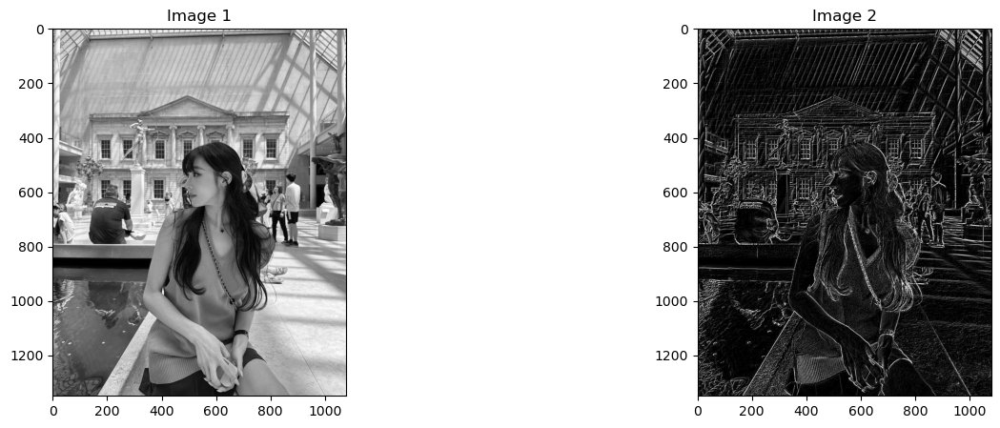

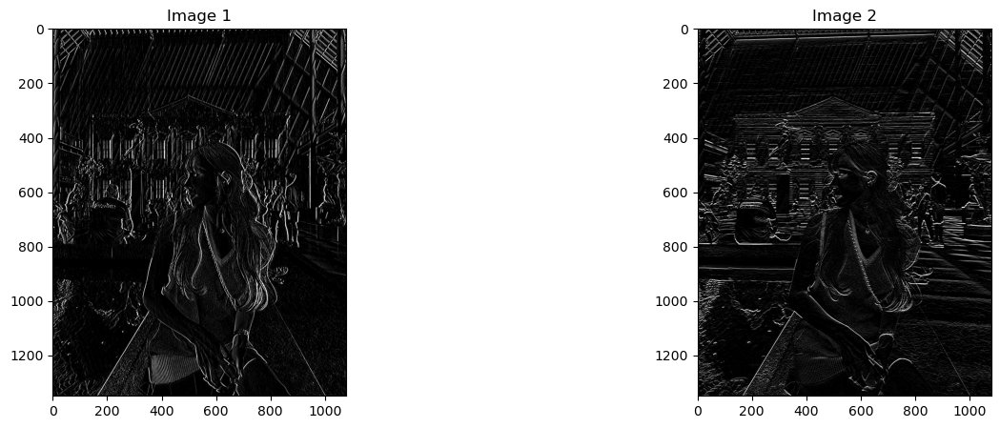

In [81]:
# Xuất ảnh xám
image_gray_edge_sobelX = cv2.filter2D(image_gray, -1, kernel_sobel_X)
image_gray_edge_sobelY = cv2.filter2D(image_gray, -1, kernel_sobel_Y)
image_gray_edge = image_gray_edge_sobelX + image_gray_edge_sobelY

ShowTwoImages(image_gray, image_gray_edge)
ShowTwoImages(image_gray_edge_sobelX, image_gray_edge_sobelY)